<a href="https://colab.research.google.com/github/Hung369/MNIST-Diffusion/blob/main/Diffusion.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!pip install diffusers["torch"] transformers

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.7/2.7 MB 11.9 MB/s eta 0:00:00


In [ ]:
import diffusers
from dataclasses import dataclass
import matplotlib.pyplot as plt
from tqdm.auto import tqdm
import numpy as np
import accelerate
import torch
import os
import torchvision
import torchvision.datasets as datasets


In [ ]:
@dataclass
class Config:
    image_size = 32
    train_batch_size = 32
    eval_batch_size = 32
    num_epochs = 5
    gradient_accumulation_steps = 1
    learning_rate = 1e-4
    lr_warmpup_steps = 500
    mixed_precision = 'fp16'
    seed = 0

config = Config()

In [ ]:
model = diffusers.UNet2DModel(
    sample_size=config.image_size,
    in_channels=1,
    out_channels=1,
    layers_per_block=2,
    block_out_channels=(128,128,256,512),
    down_block_types=(
        "DownBlock2D",
        "DownBlock2D",
        "AttnDownBlock2D",
        "DownBlock2D",
    ),
    up_block_types=(
        "UpBlock2D",
        "AttnUpBlock2D",
        "UpBlock2D",
        "UpBlock2D",
    ),
)

noise_scheduler = diffusers.DDPMScheduler(num_train_timesteps=200)

@torch.no_grad()
def sample(unet, scheduler, seed, save_process_dir=None):
    torch.manual_seed(seed)

    if save_process_dir:
        if not os.path.exists(save_process_dir):
            os.mkdir(save_process_dir)

    # How many timestpes for backward process
    timesteps = 200
    scheduler.set_timesteps(timesteps)
    image = torch.randn((1,1,32,32)).to(model.device)
    num_steps = max(noise_scheduler.timesteps).numpy()

    for t in noise_scheduler.timesteps:
        model_output = unet(image,t)['sample']
        image = scheduler.step(model_output, int(t), image, generator=None)['prev_sample']
        if save_process_dir:
            save_image = torchvision.transforms.ToPILImage()(image.squeeze(0))
            save_image.resize((256,256)).save(
                os.path.join(save_process_dir,"seed-"+str(seed)+"_"+f"{num_steps-t.numpy():03d}"+".png"),format="png")

    return torchvision.transforms.ToPILImage()(image.squeeze(0))

The cache for model files in Transformers v4.22.0 has been updated. Migrating your old cache. This is a one-time only operation. You can interrupt this and resume the migration later on by calling `transformers.utils.move_cache()`.


0it [00:00, ?it/s]

In [ ]:
def plot_mnist_images(dataset):
    fig, axs = plt.subplots(nrows=2, ncols=5, figsize=(10, 5))
    axs = axs.ravel()

    for i in range(10):
        image = np.array(dataset[i][0]).reshape(28, 28)
        axs[i].imshow(image, cmap='gray')
        axs[i].axis('off')

    plt.tight_layout()
    plt.show()


def plot_mnist_images_noise(dataset):
    fig, axs = plt.subplots(nrows=2, ncols=5, figsize=(10, 5))
    axs = axs.ravel()

    for i in range(10):
        noise = torch.randn(dataset[0][0].shape)
        timesteps = torch.LongTensor([199])
        noisy_image = noise_scheduler.add_noise(dataset[0][0], noise, timesteps)
        image = torchvision.transforms.ToPILImage()(noisy_image.squeeze(1)).resize((256,256))
        axs[i].imshow(image, cmap='gray')
        axs[i].axis('off')

    plt.tight_layout()
    plt.show()


def transform(dataset, config):
    preprocess = torchvision.transforms.Compose(
        [
            torchvision.transforms.Resize(
                (config.image_size, config.image_size)),
            torchvision.transforms.ToTensor(),
            torchvision.transforms.Lambda(lambda x: 2*(x-0.5)),
        ]
    )
    data = [(preprocess(image), label) for image, label in dataset]
    return data

In [ ]:
def train(config, model, optimizer, lr_scheduler, train_loader, noise_scheduler):

    accelerator = accelerate.Accelerator(
        mixed_precision=config.mixed_precision,
        gradient_accumulation_steps=config.gradient_accumulation_steps,
    )

    model, optimizer, train_loader, lr_scheduler = accelerator.prepare(
        model, optimizer, train_loader, lr_scheduler
    )

    for epoch in range(config.num_epochs):
        progress_bar = tqdm(total=len(train_loader),
                            disable=not accelerator.is_local_main_process)
        progress_bar.set_description(f"Epoch {epoch}")

        for step, batch in enumerate(train_loader):
            clean_images, labels = batch
            #clean_images = batch['images']

            noise = torch.randn(clean_images.shape).to(clean_images.device)
            batch_size = clean_images.shape[0]

            # Sample a set of random time steps for each image in mini-batch
            timesteps = torch.randint(
                0, noise_scheduler.num_train_timesteps, (batch_size,), device=clean_images.device)

            noisy_images=noise_scheduler.add_noise(clean_images, noise, timesteps)

            with accelerator.accumulate(model):
                noise_pred = model(noisy_images, timesteps)["sample"]
                loss = torch.nn.functional.mse_loss(noise_pred,noise)
                accelerator.backward(loss)

                accelerator.clip_grad_norm_(model.parameters(),1.0)
                optimizer.step()
                lr_scheduler.step()
                optimizer.zero_grad()

            progress_bar.update(1)
            logs = {
                "loss" : loss.detach().item(),
                "lr" : lr_scheduler.get_last_lr()[0],
            }
            progress_bar.set_postfix(**logs)

    accelerator.unwrap_model(model)

In [ ]:
config.num_epochs = 5
config.learning_rate = 1e-4
config.train_batch_size = 64
config.eval_batch_size = 64

In [ ]:
dataset = datasets.MNIST(root='./data', train=True, download=True, transform=None)
dataset = transform(dataset, config)

train_loader = torch.utils.data.DataLoader(dataset, batch_size=config.train_batch_size, shuffle=True)
optimizer = torch.optim.AdamW(model.parameters(),lr=config.learning_rate)
lr_scheduler = diffusers.optimization.get_cosine_schedule_with_warmup(optimizer=optimizer,num_warmup_steps=config.lr_warmpup_steps,
                                                                      num_training_steps=len(train_loader) * config.num_epochs)

train(config, model, optimizer, lr_scheduler, train_loader, noise_scheduler)
torch.save(model.state_dict(), 'checkpoint.pth')

/usr/local/lib/python3.10/dist-packages/accelerate/accelerator.py:494: FutureWarning: `torch.cuda.amp.GradScaler(args...)` is deprecated. Please use `torch.amp.GradScaler('cuda', args...)` instead.
  self.scaler = torch.cuda.amp.GradScaler(**kwargs)


  0%|          | 0/938 [00:00<?, ?it/s]

/usr/local/lib/python3.10/dist-packages/diffusers/configuration_utils.py:140: FutureWarning: Accessing config attribute `num_train_timesteps` directly via 'DDPMScheduler' object attribute is deprecated. Please access 'num_train_timesteps' over 'DDPMScheduler's config object instead, e.g. 'scheduler.config.num_train_timesteps'.
  deprecate("direct config name access", "1.0.0", deprecation_message, standard_warn=False)


  0%|          | 0/938 [00:00<?, ?it/s]

  0%|          | 0/938 [00:00<?, ?it/s]

  0%|          | 0/938 [00:00<?, ?it/s]

  0%|          | 0/938 [00:00<?, ?it/s]

In [ ]:
%mkdir result

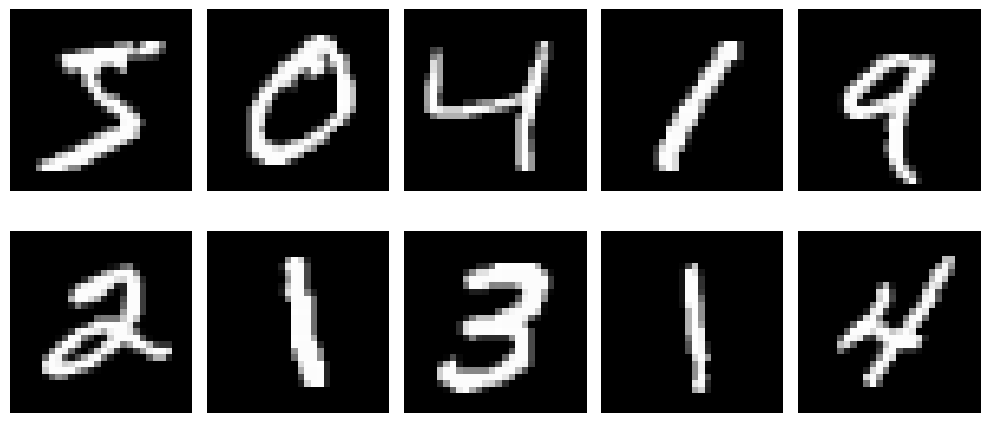

In [ ]:
dataset = datasets.MNIST(root='./data', train=True, download=True, transform=None)

# Plots the first ten images
plot_mnist_images(dataset)

# Transform images
dataset = transform(dataset, config)


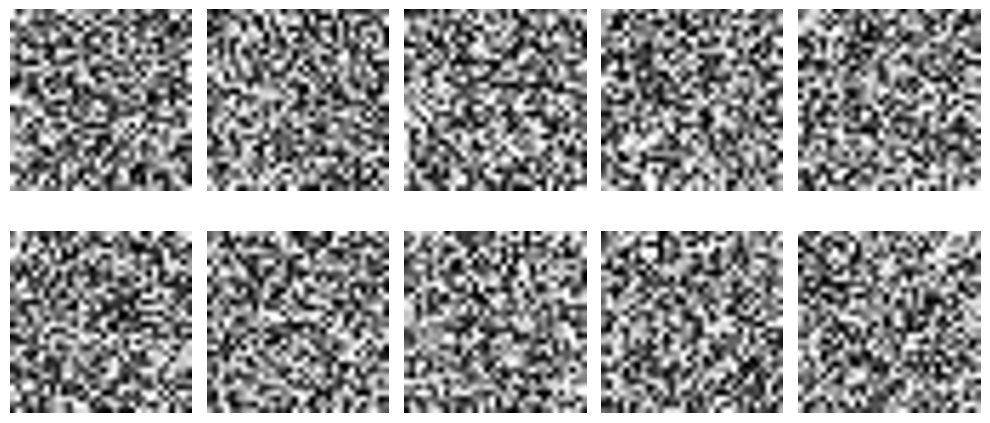

In [ ]:
# Plot first ten images with Gaussian noise added
plot_mnist_images_noise(dataset)

In [ ]:
# loads model from checkpoint trained for 5 epochs
state_dict = torch.load('checkpoint.pth')
model.load_state_dict(state_dict)

sample_image = sample(model, noise_scheduler, 4, "./result")

<ipython-input-12-931dafe7d71e>:2: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  state_dict = torch.load('checkpoint.pth')


In [ ]:
import imageio
images = []
for filename in sorted(os.listdir('./result')): # create a diffusion process gif from all the images in result folder
  if filename.endswith('.png'):
    img_path = os.path.join('./result', filename)
    images.append(imageio.imread(img_path))

imageio.mimsave('diffusion_process.gif', images, fps=10)


<ipython-input-38-437c5e174ca0>:6: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  images.append(imageio.imread(img_path))


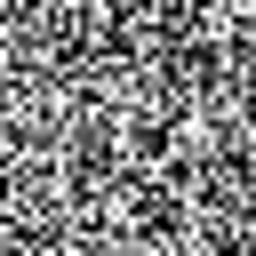

In [ ]:
from IPython.display import Image
Image(filename='diffusion_process.gif')


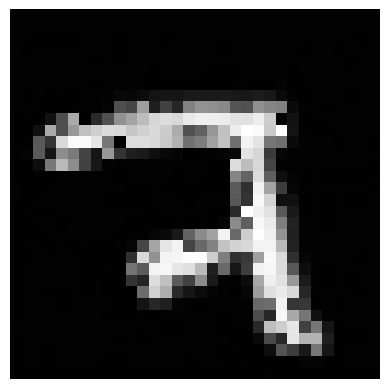

In [ ]:
plt.imshow(sample_image, cmap='gray') # Display the result
plt.axis('off')
plt.show()
